# Tutorial for simulating, visualising, and fitting N-periodic SSFP signals

This is a tutorial to accompany the paper *'SSFP as an alternative to multi-echo gradient echo'* authored by Lally PJ, Jin Y, Huo Z, Beitone C, Chiew M, Matthews PM, Miller KL and Bangerter NK. Many thanks to Brian Hargreaves (http://mrsrl.stanford.edu/~brian/bloch/) & Peder Larson (https://larsonlab.github.io/MRI-education-resources/) who have made their excellent Bloch simulators freely available - these functions borrow heavily from both implementations.

By running through this code you should be able to simulate the behaviour of N-periodic SSFP acquisitions, visualise their behaviour in terms of constituent isochromats, and fit their apparent complicated magnetisation behaviour to a simple analytical form.

***
### 1) Import functions and libraries 

To start with, we can just import the functions we will be using later, as well as some useful fixed parameters.

In [2]:
from funcs import *
from matplotlib import animation, rcParams
from IPython.display import HTML
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

rcParams['animation.embed_limit'] = 2**128
gamma_bar = 42.58e6 # Gamma bar in Hz/T
t_res = 5e-4 # Frame rate of simulation in seconds

***
### 2) Choose the simulation parameters, and simulate the buildup to the steady state

Now you can choose some of the parameters that will affect your simulation results. These will depend on:
- $T_1$
- $T_2$
- $\alpha$
- $TR$
- number of isochromats

You can also choose the periodicity of the off-resonance profile $N$, which is what we are most interested in here. This sets the quadratic RF phase cycling increment such that the phase of the $n$th pulse is $n^2$/$180N$ degrees


In [3]:
### Experimental parameters
T1 = 800e-3 # % T1 in seconds 
T2 = 50e-3 # T2 in seconds 
alpha = 10 # Flip angle of the RF pulse in degrees
t_rf = 1e-3 # duration of the RF pulse in seconds
t_tr = 6e-3 # duration of the TR in seconds
n_iso = 300 # number of isochromats to simulate (set this to be even)
N = 12 # Periodicity of the quadratic phase cycling set 

Next we will setup some of the necessary parameters for the simulation, based on what has been requested

In [4]:
### Visualisation parameters 
noTRprep = N*((np.rint(5*T1/t_tr).astype(np.int32))//N) # How many TRs to simulate until steady state reached
noTRvis = N*2 # How many TRs to visualise in the final animation
npts_rf=np.rint(t_rf/t_res).astype(np.int32) # Calculated number of frames to visualise full RF pulse
npts_tr=np.rint(t_tr/t_res).astype(np.int32) # Calculated number of frames to visualise full RF pulse

### Calculations 
#Make sure we have an even number of isochromats
n_iso = 2*np.rint(n_iso/2).astype(np.int32)
# B1 strength we need for flip angle given chosen RF pulse duration 
B1 = np.deg2rad(alpha) / (2*np.pi*gamma_bar*t_rf) 
# Range of B0 inhomogeneity needed to cover a range of off-resonance of 2/TR
dB_relax = 1. / (gamma_bar*t_tr)
dB0 = np.linspace(-dB_relax,dB_relax,n_iso+1)[0:-1]
# Sequence of RF phases to give N periodic behaviour
phi_array = np.arange(0,noTRprep+noTRvis)**2/N*np.pi


### Setup equilibrium magnetisation vectors for all isochromats
M0 = np.array([0.,0.,1.]) # Starting again with M in the +z direction
#global M
M=np.tile(M0.reshape(3,1),(1,np.size(dB0))) # Our M vector is now 4D.: 3D vector + dB0 

Now we can define our pulse sequence as a series of blocks. Each block occurs sequentially for a defined period of time, during which the B1 magnitude and phase are set to a chosen value.

In [5]:
### Pulse sequence expressed as a series of blocks, with timings, |B1|, B1 phase 
t_events = np.zeros([2*noTRprep,3])  # Setup empty array of instructions, split into 2*noTRprep blocks
t_events[:,0]=np.tile([t_rf,t_tr-t_rf],noTRprep) # Timing for RF pulse (1st block), then free precession (2nd block) 
t_events[:,1]=np.tile([B1,0],noTRprep) # B1 magnitude for RF pulse (1st block), then off for free precession (2nd block)
t_events[:,2]=np.array([phi_array[0:noTRprep],np.zeros(noTRprep)]).transpose().flatten() # B1 phase for RF pulse (1st block), then off for free precession (2nd block)

Finally, we can run the Bloch simulation given the pulse sequence defined above

In [6]:
### DO THE SIMULATION
print("Simulating "+str(noTRprep)+" TRs in prep phase...")
M = bloch_sim_events(M,t_events,T1,T2,dB0,gamma_bar)
print("Prep TRs simulated.")
print("Magnetisation is now in the steady state - next step is to visualise behaviour.")

Simulating 660 TRs in prep phase...
Prep TRs simulated.
Magnetisation is now in the steady state - next step is to visualise behaviour.


***
## 3) Visualise the magnetisation behaviour over successive TRs in the steady state

Now we will visualise the isochromat behaviour across successive TRs while in the steady state. To do this, we split up the sequence timing blocks to agree with the temporal resolution we have chosen for visualisation.

In [7]:
[fig,ax1,ax2,ax3,tt,Mpc1,Mpc2,Mxy1]=setup_M_plots(M,dB0)

### Pulse sequence expressed as a series of blocks, with timings, |B1|, B1 phase 
t_events = np.zeros([npts_tr*noTRvis,3])  # Setup empty array of instructions, split into frames*noTRvis blocks
time_blocks = np.ones(npts_tr*noTRvis)*t_res
phi_blocks = []
rf_blocks = []
for idx in range(noTRvis,0,-1):
    rf_blocks = np.append(rf_blocks,np.repeat(B1,npts_rf))
    phi_blocks = np.append(phi_blocks,np.repeat(phi_array[-idx],npts_rf))
    rf_blocks = np.append(rf_blocks,np.zeros(npts_tr-npts_rf))
    phi_blocks = np.append(phi_blocks,np.zeros(npts_tr-npts_rf))
t_events[:,0]=time_blocks # Timing for RF pulse (1st block), then free precession (2nd block) 
t_events[:,1]=rf_blocks # B1 magnitude for RF pulse (1st block), then off for free precession (2nd block)
t_events[:,2]=phi_blocks # B1 phase for RF pulse (1st block), then off for free precession (2nd block)


vec_sz = ax1.get_xlim()[1]
def bloch_sim(t):
    global M
    M = bloch_sim_events(M,t_events[t,:],T1,T2,dB0,gamma_bar)
    
    tt.set_text('TR '+str(np.mod(int(t//npts_tr),N)+1)+' / '+str(N))
    update_M_plots(dB0,M,ax1,ax2,ax3,Mpc1,Mpc2,Mxy1)
    
    if t>0:
        ax1.lines[-1].remove()
        ax2.lines[-1].remove()
    ax1.plot([0,np.sin(t_events[t,2])*(vec_sz*(t_events[t,1]>0))],[0,(B1>0)*-np.cos(t_events[t,2])*(vec_sz*(t_events[t,1]>0))],lw=4,color='k')
    ax2.plot([0,np.sin(t_events[t,2])*(vec_sz*(t_events[t,1]>0))],[0,(B1>0)*-np.cos(t_events[t,2])*(vec_sz*(t_events[t,1]>0))],lw=4,color='k')
    
    if t==noTRvis:
        plt.close()

print("Simulating TRs for visualisation...")
HTML(animation.FuncAnimation(fig, bloch_sim, frames=int(noTRvis*npts_tr),init_func=lambda: None, interval=60).to_jshtml())

Simulating TRs for visualisation...


So we have N-periodic mangetisation profiles! You can play with this to produce other schemes, e.g. FEMR (MRM [1999] Vasanwala S, Pauly J, Nishimura DG) requires N=2.

You will notice that if we use larger N (e.g. N=12), the N-periodic magnetisation profile $|M_{xy}|$ looks pretty complicated. However, we can more easily describe this in terms of its Fourier components in the off-resonance dimension. These are equivalent to the F-states in the extended phase graph formalism.

To simplify the N-periodic behaviour, let's repeat the simulation and express the $M_{xy}$ signal at the $TE$ (=$TR/2$) as a Fourier series expansion along the off-resonance dimension.
***
### 4) Fourier series expansion of $M_{xy}(TE)$

Let's visualise the N-periodic steady state magnetisation at $TE=TR/2$ in terms of its F-state components via Fourier expansion.

In [8]:
[fig,ax1,ax2,tt,Mxy1]=setup_Fstate_plots(M,dB0)
#fig_new=plt.figure(figsize=(12,5))
### Pulse sequence expressed as a series of blocks, with timings, |B1|, B1 phase 
t_events = np.zeros([3*(noTRvis),3])  # Setup empty array of instructions, split into 2*noTRprep blocks
t_events[:,0]=np.tile([t_rf,0.5*(t_tr-t_rf),0.5*(t_tr-t_rf)],(noTRvis)) # Timing for RF pulse (1st block), then free precession (2nd block) 
t_events[:,1]=np.tile([B1,0,0],(noTRvis)) # B1 magnitude for RF pulse (1st block), then off for free precession (2nd block)
t_events[:,2]=np.array([phi_array[-noTRvis::],np.zeros(noTRvis),np.zeros(noTRvis)]).transpose().flatten() # B1 phase for RF pulse (1st block), then off for free precession (2nd block)


def bloch_sim(t):
    global M    
    if t==0:
        M = bloch_sim_events(M,t_events[0:2,:],T1,T2,dB0,gamma_bar)
    else:
        M = bloch_sim_events(M,t_events[3*t-1:3*t+2,:],T1,T2,dB0,gamma_bar)

    # correct M phase to be locked to RF pulse
    Mplot=M*np.exp(1j*phi_array[-noTRvis+t])    
    update_Fstate_plots(dB0,Mplot,ax1,ax2,Mxy1)

    if t==0:
        plt.close()

print("Simulating TRs for visualisation...")
HTML(animation.FuncAnimation(fig, bloch_sim, frames=int(noTRvis),init_func=lambda: None, interval=60).to_jshtml())


Simulating TRs for visualisation...


### Amplitude of the Fourier components
The shape of the complicated off-resonance profile can be explained in terms of the amplitudes of its Fourier components on the right figure above: 
- Magnetisation excited in the F=0 state (at the centre of the right figure) undergoes $T_2$ decay as it progresses across several TRs, resulting in a monoexponential decay of signals moving from F=0 to F=N-1.
- At this point, some magnetisation is refocused into the -N state (left side of the right figure), where it undergoes $T_2$ decay as it progresses back to the F=0 state
- Magnetisation in the F=6 state which is not refocused continues to decay with $T_2$ up to state F=2N-1.
- Note that refocusing occurs again for the state F=2N
Assuming a Lorentzian distribution of $B_0$ in an imaged voxel, the monoexponential decay of signal across the first N states (F=0 to F=N-1) is given by a $T_2^*$ distribution.


***
### 5) Fitting the Fourier series to exponential decay

Finally, let's fit signals F=0 to F=N-1 to a monoexponential decay curve. The F=0 signal has evolved over a period of TE, and the F=n signal has evolved over a period of TE+nTR at the point of measurement. We can fit these signals with different evolution times to a monoexponential decay, and verify that we obtain an estimate of $T_2$ which is equal to the ground truth in the simulation.


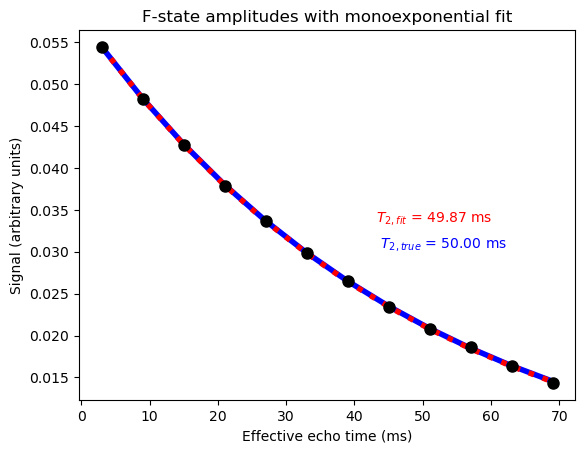

In [9]:
F0_idx = np.int32(n_iso/2)+1
te_list = (np.arange(0,N)+0.5)*t_tr

F = np.fft.ifftshift(np.fft.fft(np.fft.fftshift(1j*M[0,:]+M[1,:])))/len(dB0)
F_list = np.abs(F[F0_idx:F0_idx+(2*N):2])

[R2,C]=np.polyfit((np.arange(0,N)+0.5)*t_tr,-np.log(np.abs(F[F0_idx:F0_idx+(2*N):2])),1)

plt.title('F-state amplitudes with monoexponential fit')
plt.xlabel('Effective echo time (ms)')
plt.ylabel('Signal (arbitrary units)')

plt.plot(te_list*1e3,np.exp(-(te_list/T2+C)),'b',lw=4)
plt.plot(te_list*1e3,np.exp(-(R2*te_list+C)),':r',lw=4)
plt.plot(te_list*1e3,F_list,'ok',markersize=8)

T2_res = '$T_{2,fit}$ = ' + "%.2f" % (1000./R2) + ' ms '
T2_true = '\n\n $T_{2,true}$ = ' + "%.2f" % (T2*1000) + ' ms '
plt.text(np.mean(te_list*1e3)*1.2,np.mean(F_list)*1.1,T2_res,color='r');
plt.text(np.mean(te_list*1e3)*1.2,np.mean(F_list)*1,T2_true,color='b');

### 6) $T_2$* estimation

With $B_0$ inhomogeneity, the off-resonance profile is convolved with the intra-voxel frequency distribution. So if we have a Lorentzian distribution of off-resonance, we obtain an additional monoexponential decay term across the Fourier series with a time constant of $T_2'$.
